In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import obspy
from obspy.clients.fdsn import Client
from obspy import UTCDateTime
from glob import glob
from tqdm import tqdm
from obspy.geodetics.base import gps2dist_azimuth
import matplotlib.ticker as ticker
import os

In [2]:
client = Client('IRIS')

In [3]:
def get_info(inventory):
    lats = []
    lons = []
    net = []
    sta = []
    loc = []
    chan = []
    for i in range(len(inventory)):
        for k in range(len(inventory[i])):
            for j in range(len(inventory[i][k])):
                net.append(inventory[i].code)
                sta.append(inventory[i][k].code)
                loc.append(inventory[i][k][j].location_code)
                chan.append(inventory[i][k][j].code)
                lats.append(inventory[i][k][j].latitude)
                lons.append(inventory[i][k][j].longitude)

    net = np.array(net)
    sta = np.array(sta)
    loc = np.array(loc)
    chan = np.array(chan)
    lats = np.array(lats)
    lons = np.array(lons)

    df = pd.DataFrame({'Network':net, 'Station':sta, 'Location':loc,'Channel':chan, 'latitude':lats, 'longitude':lons},index=net)
    if len(df[df['Network']=='SY'].values) != 0:
        df.drop(['SY'],inplace=True)
    return df

In [31]:
files_csv = glob("../../Tasks/Task_3/Anomalously_deep_events/*.csv")
df = pd.read_csv(files_csv[0])

In [11]:
df = pd.read_csv(files_csv[0])
df

,Unnamed: 0,Longitude,Latitude,Depth,Time
0,0,-111.209833,44.763000,26.17,2015-10-14 05:16:23
1,1,-111.125500,44.617833,25.98,2002-12-05 13:01:56
2,2,-111.142833,44.725333,31.22,1994-07-29 19:28:16
3,3,-111.143167,44.854000,36.62,1994-10-21 12:56:40
4,4,-111.098000,44.490333,42.10,1994-11-27 11:37:54
5,5,-111.084000,44.655833,20.47,1998-11-13 14:44:51
6,6,-111.004500,44.657333,23.55,1995-07-05 19:32:02
7,7,-110.943500,44.716833,28.26,1985-02-17 14:34:20
8,8,-110.929500,44.721667,23.55,2001-01-02 10:50:12
9,9,-110.937833,44.773833,19.20,2004-03-02 23:53:30


In [26]:
UTCDateTime(df['Time'][0])

2015-10-14T05:16:23.000000Z

In [29]:
for i in tqdm(range(len(df['Time']))):
    origin_time = obspy.UTCDateTime(df['Time'][i])
    latitude= df['Latitude'][i]
    longitude=df['Longitude'][i]
    minradius=0
    maxradius=1
    starttime=origin_time - 1*60
    endtime=origin_time + 300

    try:
        inv = client.get_stations(starttime, endtime, latitude=latitude, 
                            longitude=longitude, minradius=minradius, channel='EH*,HH*,BH*',level='response', 
                            maxradius=maxradius,matchtimeseries=True)

        inv.write('/home/aakash/Desktop/Reference_Papers/Keith_Koper/Tasks/Task_3/Anomalously_deep_events//inv'+str(i)+'.xml',
                 format="STATIONXML")
    except:
        continue

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:39<00:00,  1.53s/it]


In [7]:
files = glob("../../Tasks/Task_3/Anomalously_deep_events/*.xml")
files

['../../Tasks/Task_3/Anomalously_deep_events/inv11.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv23.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv25.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv0.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv10.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv21.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv2.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv6.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv7.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv14.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv8.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv4.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv9.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv5.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv17.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv15.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv12.xml',
 '../../Tasks/Task_3/Anomalously_deep_e

In [66]:
files = glob("../../Tasks/Task_3/Anomalously_deep_events/*.csv")
df_for_time = pd.read_csv(files[0])

files = glob("../../Tasks/Task_3/Anomalously_deep_events/*.xml")

for i in tqdm(range(len(files))):
    inv = obspy.read_inventory(files[i])
    k = int(files[i].split('/')[-1].split('.')[0].split('inv')[1])
    time = obspy.UTCDateTime(df_for_time['Time'][k])
    df = get_info(inv)
    stream = obspy.Stream([])
    try:
        for i in range(len(df['Network'])):
            try:
                stream += client.get_waveforms(df['Network'][i],
                                          df['Station'][i],df['Location'][i], df['Channel'][i],
                                          starttime = time-60, 
                                           endtime = time+300,
                                          attach_response=True)
            except:
                continue
    except:
        continue
    stream.write('/home/aakash/Desktop/Reference_Papers/Keith_Koper/Tasks/Task_3/Anomalously_deep_events//stream_dlf'+str(k)+'.mseed')

  8%|█████████████▎                                                                                                                                                         | 2/25 [01:33<17:29, 45.62s/it]/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/io/mseed/core.py:840: UserWarning: File will be written with more than one different record lengths.
This might have a negative influence on the compatibility with other programs.
  warnings.warn(msg % 'record lengths')
 12%|███████████████████▉                                                                                                                                                  | 3/25 [05:29<48:42, 132.82s/it]/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/io/mseed/core.py:840: UserWarning: File will be written with more than one different record lengths.
This might have a negative influence on the compatibility with other programs.
  warnings.warn(msg % 'record lengths')
 20%|███

In [106]:
files_stream1 = glob("../../Tasks/Task_3/Anomalously_deep_events/*.mseed")
files_inv1 = glob("../../Tasks/Task_3/Anomalously_deep_events/*.xml")

In [109]:
k = []
for i in range(len(files_stream1)):
    k.append(int(files_stream1[i].split('/')[-1].split('.')[0].split('stream_dlf')[1]))
new_order = np.argsort(k)

files_stream = []

for i in range(len(files_stream1)):
    files_stream.append(files_stream1[new_order[i]])

In [111]:
k = []
for i in range(len(files_inv1)):
    k.append(int(files_inv1[i].split('/')[-1].split('.')[0].split('inv')[1]))
new_order = np.argsort(k)

files_inv = []

for i in range(len(files_inv1)):
    files_inv.append(files_inv1[new_order[i]])

In [135]:
## Common Parameters
f1 = 1
f2 = 10
filter_type = 'bandpass'
dist_range = (0,110)
bins = 25

def get_distances(stream, inventory, ev_latitude, ev_longitude):
    for i in range(len(stream)):
        net = stream[i].stats.network
        sta = stream[i].stats.station
        inveen = inventory.select(net,sta)
        lat = inveen[0][0].latitude
        lon = inveen[0][0].longitude
        dist = gps2dist_azimuth(ev_latitude, ev_longitude, lat, lon)[0]/1000
        ba = gps2dist_azimuth(ev_latitude, ev_longitude, lat, lon)[1]
        stream[i].stats.distance = dist
        stream[i].stats.back_azimuth = ba
        
    return stream

def compute_snr(trace):
    rms_noise = np.sqrt(np.mean((trace.data[0:30*int(trace.stats.sampling_rate)])**2))
    rms_signal = np.sqrt(np.mean((trace.data[50*int(trace.stats.sampling_rate):80*int(trace.stats.sampling_rate)])**2))
    snr = rms_signal/rms_noise
    return snr

def prs(ev_latitude, ev_longitude,stream, inventory, channel='*HR', filter_type='bandpass',
       freqmin=f1,freqmax=f2,  bins = 25, dist_range = (0,110),
       ):
    # stream should contain both the N and E component. 
    # Adding distance and back azimuths to all the traces
    
    try:
        stream.merge(fill_value = 0)
    
    except:
        print('No')
    
    else:
        stream = get_distances(stream, inventory, ev_latitude, ev_longitude)


        # removing instrument response    
        stream.remove_response(inventory=inventory,output='DISP')

        # rotating the stream
        stream.rotate(method='NE->RT')


        # converting it into stream
        stream = obspy.Stream(st_dlf)

        # selecting the 'R' channel
        st_R = stream.select(channel=channel)

        # selecting new inventory
        inv1 = inventory.select(channel='*HR')

        # adding individual distances which will help in plot
        dist = [] 
        for i in range(len(st_R)):
            dist.append(st_R[i].stats.distance)


        #st_dlf.taper(max_percentage=0.1)
        st_R.filter(type=filter_type,freqmin=f1, freqmax=f2)

        # Bin size
        a,_ = np.histogram(dist, bins=bins, range=dist_range)
        b = np.cumsum(a)


        # sort stream according to epicentral distance
        st_sorted = []
        dist_sorted = []
        for i in range(len(dist)):
            st_sorted.append(st_R[np.argsort(dist)[i]])
            dist_sorted.append(dist[np.argsort(dist)[i]])
        st_sorted = obspy.Stream(st_sorted)



        # computing snr of the individual bins and then pick out the index of the waveform with highest snr in each bin
        snr = []
        for i in range(b[0]):
            snr.append(compute_snr(st_sorted[i]))

        ## pick index of a waveform in first bin and save it
        idx_max = []
        if len(snr) != 0:
            idx_max.append(np.argmax(snr))



        ## pick index of a waveform corresponding to highest SNR of remaining bins. 
        for i in range(len(b)-1):
            snr = []
            idx = []
            for k in range(b[i],b[i+1]):
                snr.append(compute_snr(st_sorted[k]))
                idx.append(k)


            try:    
                idx_max.append(idx[np.argmax(snr)])
            except:
                continue

        return idx_max, st_sorted, dist_sorted



def axes_plot(index, st_sorted, dist, 
              row = 0, col = 0, scale = 2, ylim = [0,100], xlim = [0,300]):

    dist_labels = []
    ylabels = []
    for k in range(len(index)):
        i = index[k]
        t = np.linspace(0,300,len(st_sorted[i].data))
    
      
        ax1[row,col].plot(t, dist[i]+scale*st_sorted[i].data/np.max(abs(st_sorted[i].data)))
        dist_labels.append(np.around(dist[i],2))
        ylabels.append(st_sorted[i].stats.network+'.'+st_sorted[i].stats.station+'.'+
                  st_sorted[i].stats.channel)

    ax1[row,col].spines['left'].set_linewidth(3)
    ax1[row,col].spines['bottom'].set_linewidth(3)
    ax1[row,col].spines['top'].set_linewidth(3)
    ax1[row,col].spines['right'].set_linewidth(3)    
    
    ax2 = ax1[row,col].twinx()
    ax1[row,col].set_yticks(ticks=dist_labels,labels=np.array(dist_labels).astype('str'))  
    ax2.set_yticks(ticks = dist_labels, labels = ylabels)
    ax1[row,col].set_xlim(xlim[0],xlim[1])
    ax1[row,col].set_ylim(ylim[0],ylim[1])
    ax2.set_ylim(ylim[0],ylim[1])



# Typical Event

In [94]:
origin_time_te = obspy.UTCDateTime(2021,8,25,18,1,34)
latitude_te= 44.781
longitude_te= -110.789
minradius=0
maxradius=1
depth_te = 14.2 
starttime_te = origin_time_te - 1*60
endtime_te = origin_time_te + 300
inv_te = client.get_stations(starttime_te, endtime_te, latitude=latitude_te, 
                    longitude=longitude_te, minradius=minradius, channel='EH*,HH*,BH*',level='response', 
                    maxradius=maxradius,matchtimeseries=True)

  8%|█████████████▎                                                                                                                                                         | 2/25 [01:48<20:05, 52.40s/it]/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/core/stream.py:2958: UserWarning: Incompatible traces (sampling_rate, dtype, ...) with same id detected. Doing nothing.
  warnings.warn(msg)
 12%|████████████████████                                                                                                                                                   | 3/25 [01:48<10:27, 28.55s/it]

No


 20%|█████████████████████████████████▍                                                                                                                                     | 5/25 [03:05<11:29, 34.49s/it]/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/core/stream.py:2958: UserWarning: Incompatible traces (sampling_rate, dtype, ...) with same id detected. Doing nothing.
  warnings.warn(msg)
 24%|████████████████████████████████████████                                                                                                                               | 6/25 [03:05<07:13, 22.82s/it]/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/core/stream.py:2958: UserWarning: Incompatible traces (sampling_rate, dtype, ...) with same id detected. Doing nothing.
  warnings.warn(msg)
 28%|██████████████████████████████████████████████▊                                                                                                                  

No
No


/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/si

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent.

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent.

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/signal/filter.py:67: UserWarning: Selected high corner frequency (10) of bandpass is at or above Nyquist (5.0). Applying a high-pass instead.
  warnings.warn(msg)
/tmp/ipykernel_6823/2739725210.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax1 = plt.subplots(nrows = 3, ncols = 2, figsize=[15,24])
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensit

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/signal/filter.p

No


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 20/25 [10:44<03:34, 42.94s/it] WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/signal/filter.py:67: UserWarning: Selected high corner frequency (10) of bandpass is at or above Nyquist (5.0). Applying a high-pass instead.
  warnings.warn(msg)
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [13:15<00:00, 31.81s/it]


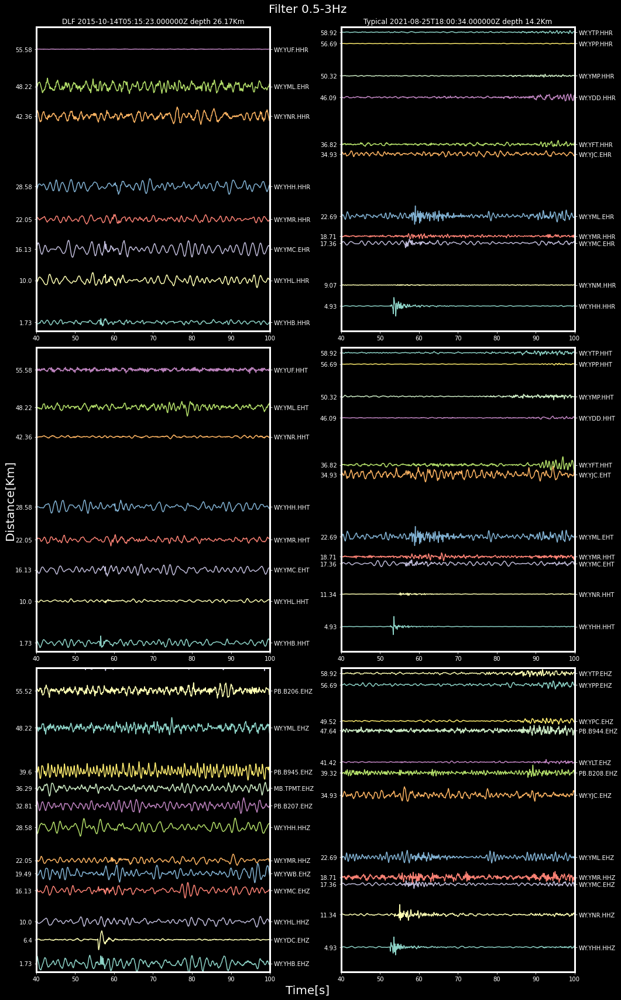

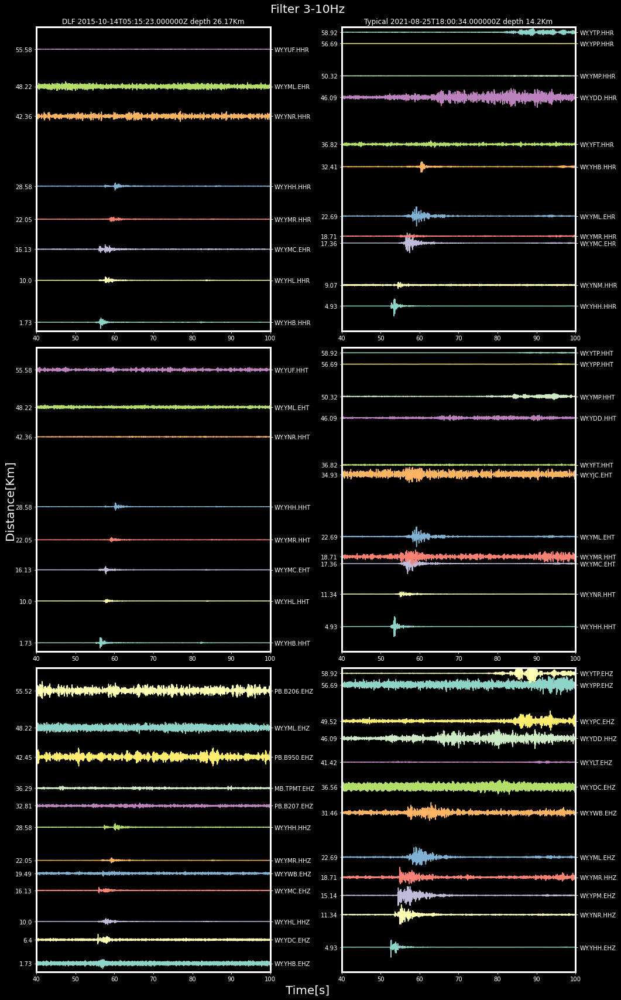

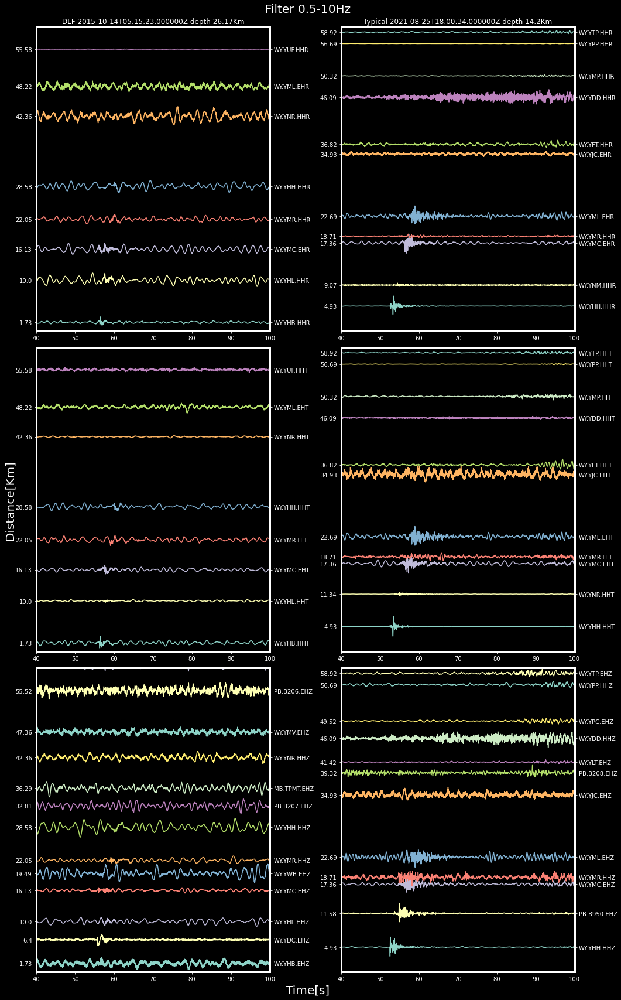

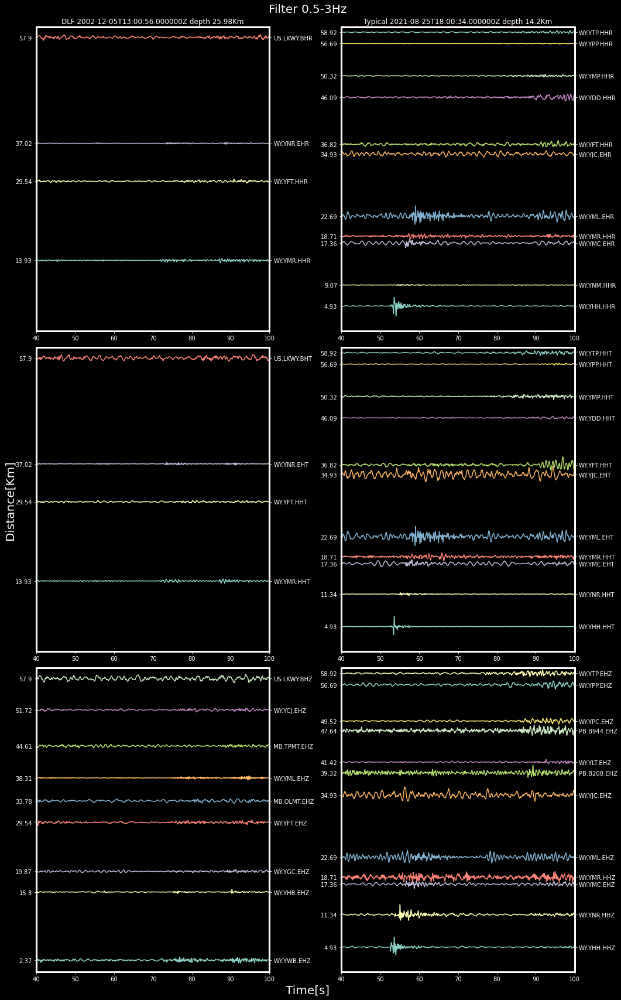

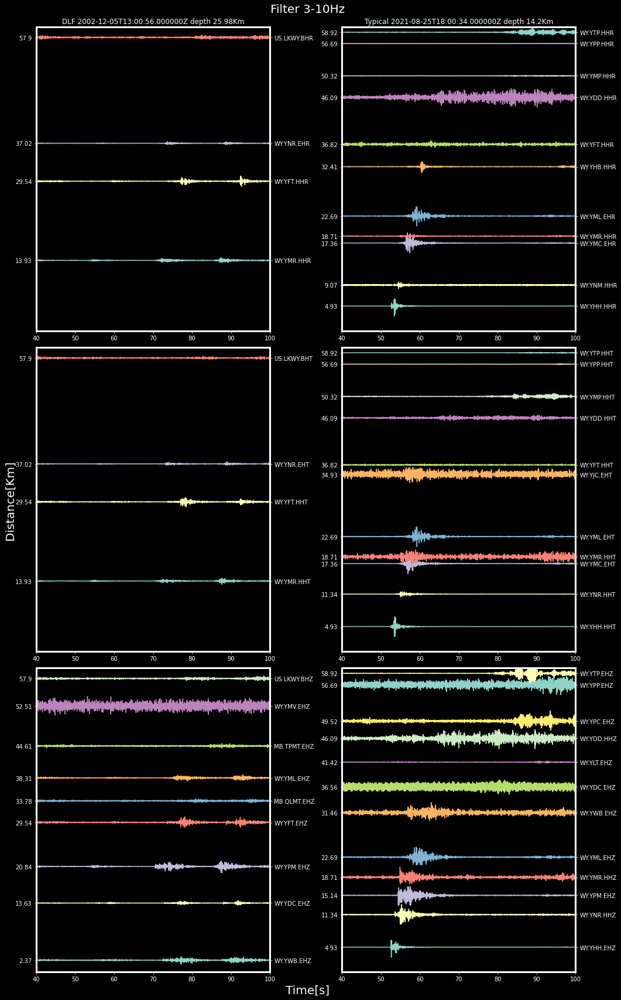

...

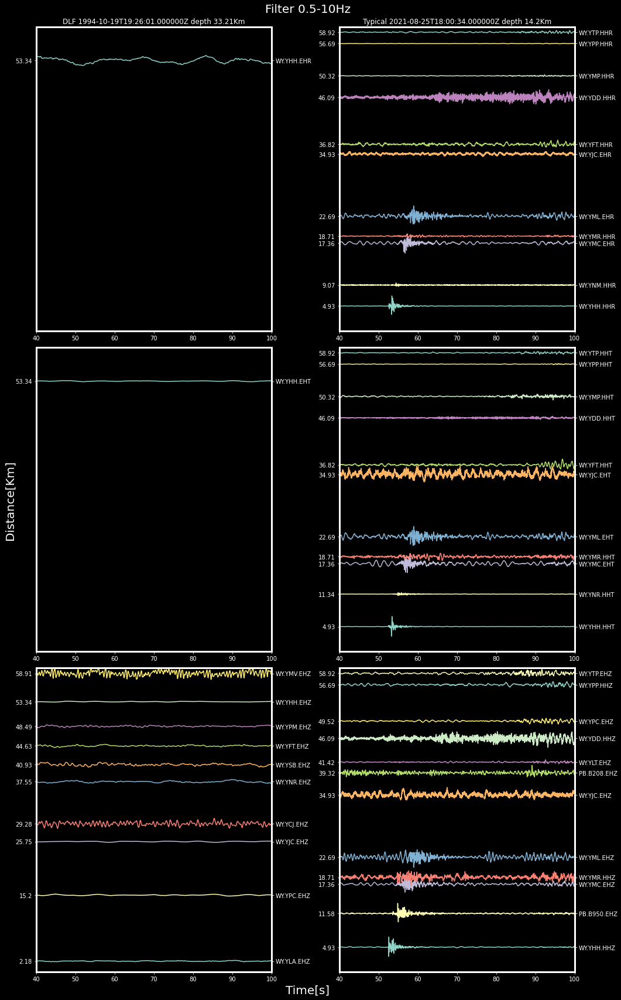

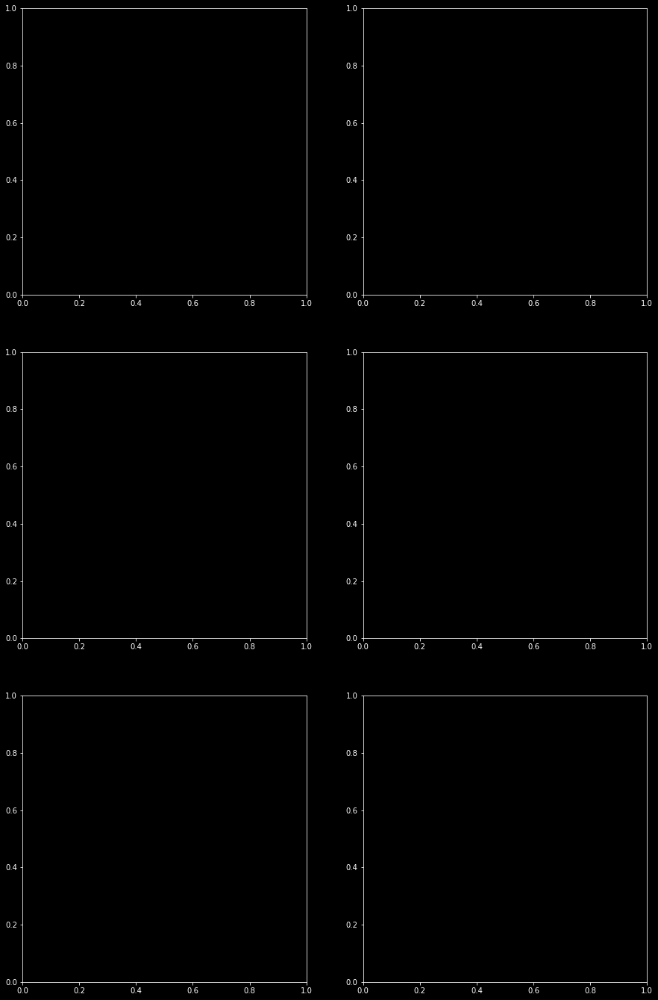

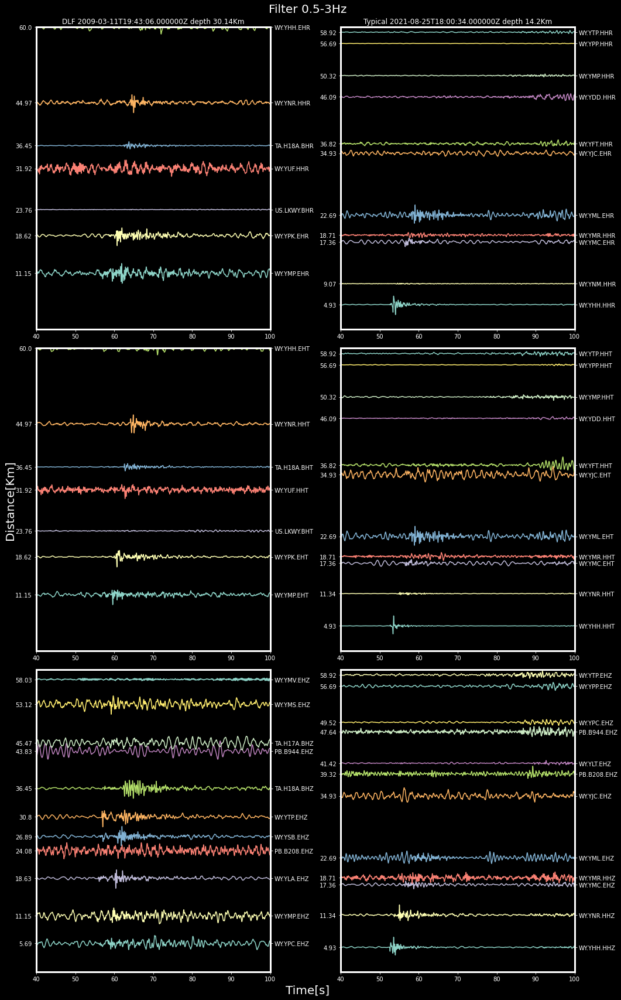

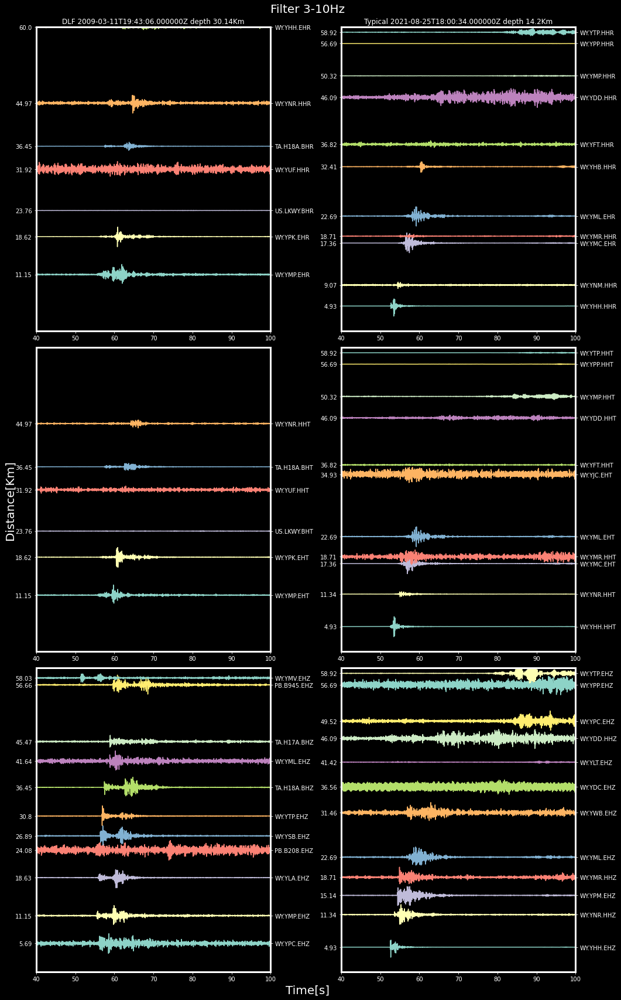

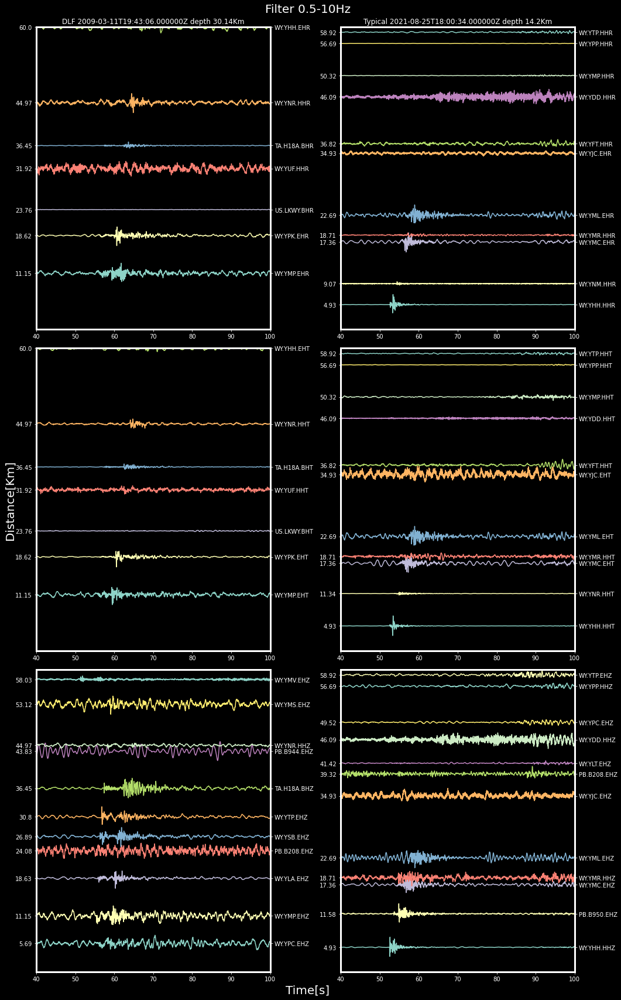

In [137]:
for h in tqdm(range(len(files_stream))): 
    ## Common Parameters
    f_low = [0.5,3,0.5]
    f_high = [3,10,10]
    try:
        for g in range(3):
            f1 = f_low[g]
            f2 = f_high[g]
            filter_type = 'bandpass'
            dist_range = (0,110)
            bins = 25
            xlim = [40,100]
            ylim = [0,60]
            chan = ['*HR','*HT','*HZ']

            files_csv = glob("../../Tasks/Task_3/Anomalously_deep_events/*.csv")
            df = pd.read_csv(files_csv[0])





            df_te = get_info(inv_te)
            dist_te = []
            ba_te = []
            for i in range(len(df_te['Network'])):
                dist_te.append(gps2dist_azimuth(latitude_te, longitude_te, df_te['latitude'][i], df_te['longitude'][i])[0]/1000)
                ba_te.append(gps2dist_azimuth(latitude_te, longitude_te, df_te['latitude'][i], df_te['longitude'][i])[1])    





            plt.style.use('dark_background')
            fig, ax1 = plt.subplots(nrows = 3, ncols = 2, figsize=[15,24])
            k = int(files_stream[h].split('/')[-1].split('.')[0].split('stream_dlf')[1])
            ev_latitude = df['Latitude'][k]
            ev_longitude = df['Longitude'][k]
            otime_dlf = obspy.UTCDateTime(df['Time'][k])
            depth_dlf = np.around(df['Depth'][k],2)


            for i in range(3):

                stream_dlf = obspy.read(files_stream[h])
                inv = obspy.read_inventory(files_inv[h])
                st_dlf = stream_dlf.copy()
                idx_max, st_dlf_sorted, dist_sorted = prs(ev_latitude, ev_longitude, stream=st_dlf,  inventory= inv, channel=chan[i], 
                                                      filter_type='bandpass',
                   freqmin=f1,freqmax=f2,  bins = bins, dist_range = dist_range)                                                 
                axes_plot(index = idx_max, st_sorted = st_dlf_sorted, dist = dist_sorted, 
                          row = i, col = 0, scale = 2, ylim = ylim, xlim = xlim)


                stream_dlf = obspy.read('/home/aakash/Desktop/Reference_Papers/Keith_Koper/Tasks//stream_te.mseed')
                st_dlf = stream_dlf.copy()
                idx_max, st_dlf_sorted, dist_sorted = prs(latitude_te, longitude_te, stream=st_dlf, inventory=inv_te, channel=chan[i], 
                                                      filter_type='bandpass',
                   freqmin=f1,freqmax=f2,  bins = bins, dist_range = dist_range)                                                 
                axes_plot(index = idx_max, st_sorted = st_dlf_sorted, dist = dist_sorted, 
                          row = i, col = 1, scale = 2, ylim = ylim, xlim = xlim)



            ax1[0,0].set_title('DLF '+str(otime_dlf-60)+' depth '+str(depth_dlf)+'Km')
            ax1[0,1].set_title('Typical '+str(origin_time_te-60)+' depth '+str(depth_te)+'Km')
            fig.suptitle('Filter '+str(f1)+'-'+str(f2)+'Hz', y = 0.99, fontsize=20)
            fig.supylabel('Distance[Km]', fontsize=20)
            fig.supxlabel('Time[s]', fontsize=20)
            fig.tight_layout()

            plt.savefig('/home/aakash/Desktop/Reference_Papers/Keith_Koper/Tasks/Task_3/29_events_prs//prs'+str(h)+'_'+str(f1)+'_'+str(f2)+'.png')
        
    except:
        continue

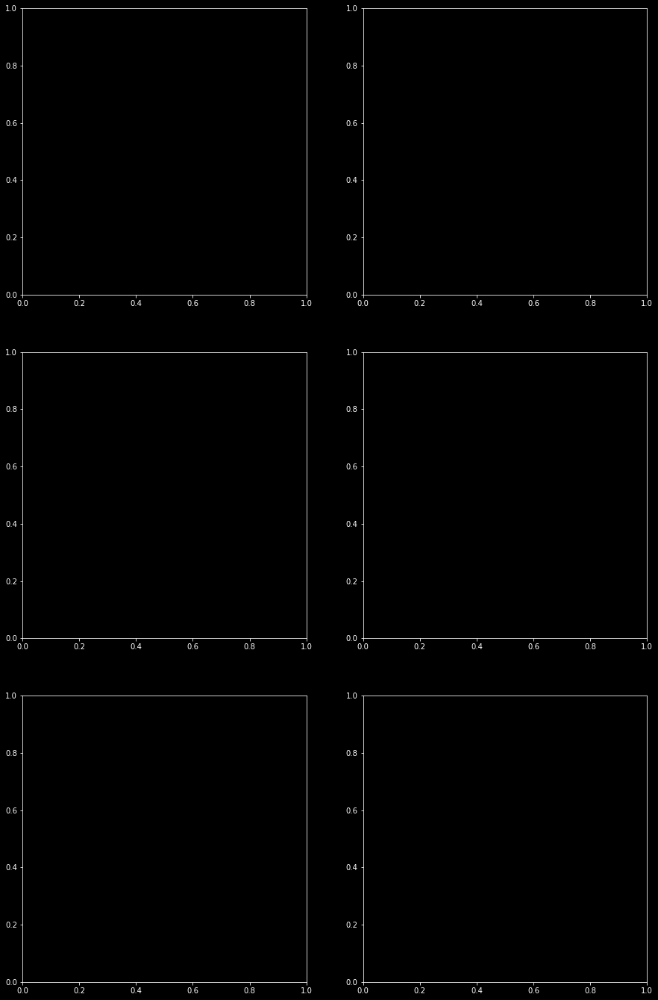

In [53]:
files_csv = glob("../../Tasks/Task_3/Anomalously_deep_events/*.csv")
df = pd.read_csv(files_csv[0])


plt.style.use('dark_background')
fig, ax1 = plt.subplots(nrows = 3, ncols = 2, figsize=[15,24])
k = int(files_stream[0].split('/')[-1].split('.')[0].split('stream_dlf')[1])
ev_latitude = df['Latitude'][k]
ev_longitude = df['Longitude'][k]

stream_dlf = obspy.read(files_stream[1])
inv = obspy.read_inventory(files_inv[20])
st_dlf = stream_dlf.copy()

df = get_info(inv)
dist = []
ba = []
for i in range(len(df['Network'])):
    dist.append(gps2dist_azimuth(ev_latitude, ev_longitude, df['latitude'][i], df['longitude'][i])[0]/1000)
    ba.append(gps2dist_azimuth(ev_latitude, ev_longitude, df['latitude'][i], df['longitude'][i])[1])

    

In [36]:
print(stream_dlf.__str__(extended=True))

48 Trace(s) in Stream:
WY.YBE..EHZ | 1995-07-05T19:31:45.610000Z - 1995-07-05T19:32:44.850000Z | 100.0 Hz, 5925 samples
WY.YBE..EHZ | 1995-07-05T19:36:29.995000Z - 1995-07-05T19:37:01.999560Z | 100.0 Hz, 3202 samples
WY.YCJ..EHZ | 1995-07-05T19:31:45.610000Z - 1995-07-05T19:32:44.850000Z | 100.0 Hz, 5925 samples
WY.YCJ..EHZ | 1995-07-05T19:36:29.995000Z - 1995-07-05T19:37:01.999560Z | 100.0 Hz, 3202 samples
WY.YDC..EHZ | 1995-07-05T19:31:45.610000Z - 1995-07-05T19:32:44.850000Z | 100.0 Hz, 5925 samples
WY.YDC..EHZ | 1995-07-05T19:36:29.995000Z - 1995-07-05T19:37:01.999560Z | 100.0 Hz, 3202 samples
WY.YFT..EHZ | 1995-07-05T19:31:45.610000Z - 1995-07-05T19:32:44.850000Z | 100.0 Hz, 5925 samples
WY.YFT..EHZ | 1995-07-05T19:36:29.995000Z - 1995-07-05T19:37:01.999560Z | 100.0 Hz, 3202 samples
WY.YGC..EHZ | 1995-07-05T19:31:45.610000Z - 1995-07-05T19:32:44.850000Z | 100.0 Hz, 5925 samples
WY.YGC..EHZ | 1995-07-05T19:36:29.995000Z - 1995-07-05T19:37:01.999560Z | 100.0 Hz, 3202 samples
WY.YHH.

In [114]:
files_inv

['../../Tasks/Task_3/Anomalously_deep_events/inv0.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv1.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv2.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv3.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv4.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv5.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv6.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv7.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv8.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv9.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv10.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv11.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv12.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv13.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv14.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv15.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv16.xml',
 '../../Tasks/Task_3/Anomalously_deep_eve

In [24]:
obspy.read_inventory(files_inv[7])

Inventory created at 2022-01-22T19:49:41.243000Z
	Created by: IRIS WEB SERVICE: fdsnws-station | version: 1.1.48
		    http://service.iris.edu/fdsnws/station/1/query?starttime=1995-07-05...
	Sending institution: IRIS-DMC (IRIS-DMC)
	Contains:
		Networks (1):
			WY
		Stations (18):
			WY.YBE (Bechler, YNP, WY, USA)
			WY.YCJ (Canyon Junction, YNP, WY, USA)
			WY.YDC (Denny Creek, YNP, MT, USA)
			WY.YFT (Old Faithful, YNP, WY, USA)
			WY.YGC (Grayling Creek, YNP, MT, USA)
			WY.YHH (Holmes Hill, YNP, WY, USA)
			WY.YIT (Gravel Pit, YNP, WY, USA)
			WY.YJC (Joseph`s Coat, YNP, WY, USA)
			WY.YLA (Lake Butte, YNP, WY, USA)
			WY.YMC (Maple Creek, YNP, WY, USA)
			WY.YML (Mary Lake, YNP, WY, USA)
			WY.YMV (Mammoth Vault, YNP, WY, USA)
			WY.YNR (Norris Junction, YNP, WY, USA)
			WY.YPC (Pelican Cone, YNP, WY, USA)
			WY.YPM (Purple Mountain, YNP, WY, USA)
			WY.YSB (Soda Butte, YNP, WY, USA)
			WY.YTP (The Promontory, YNP, WY, USA)
			WY.YWB (West Boundary, YNP, WY, USA)
		Channels (24):


In [37]:
stream_dlf.merge(fill_value = 0)

/home/aakash/anaconda3/envs/roses_2021/lib/python3.9/site-packages/obspy/core/stream.py:2958: UserWarning: Incompatible traces (sampling_rate, dtype, ...) with same id detected. Doing nothing.
  warnings.warn(msg)


Exception: Can't merge traces with same ids but differing sampling rates!

In [38]:
len(stream_dlf)

48

1

In [93]:
k = int(files_stream[0].split('/')[-1].split('.')[0].split('mseed=')[1])

IndexError: list index out of range

In [99]:
files_stream[0].split('/')[-1].split('.')[0].split('stream_dlf')

['', '6']

In [44]:
files_stream

['../../Tasks/Task_3/Anomalously_deep_events/stream_dlf6.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf19.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf13.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf15.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf14.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf5.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf18.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf11.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf25.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf21.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf2.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf4.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf0.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf24.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf23.mseed',
 '../../Tasks/T

In [46]:
files_inv[20]

'../../Tasks/Task_3/Anomalously_deep_events/inv19.xml'

In [56]:
stream = obspy.read(files_stream[1])
print(stream.__str__(extended=True))

115 Trace(s) in Stream:
IW.FLWY.00.BH1 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.FLWY.00.BH2 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.FLWY.00.BHZ | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.FXWY.00.BH1 | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 40.0 Hz, 14401 samples
IW.FXWY.00.BH2 | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 40.0 Hz, 14401 samples
IW.FXWY.00.BHZ | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 40.0 Hz, 14401 samples
IW.IMW.00.BH1  | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.IMW.00.BH2  | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.IMW.00.BHZ  | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.LOHW.00.BH1 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z |

In [50]:
stream.merge(fill_value=0)

106 Trace(s) in Stream:

WY.YPP.01.HHE | 2016-11-25T01:23:52.968393Z - 2016-11-25T01:29:27.958393Z | 100.0 Hz, 33500 samples
...
(104 other traces)
...
WY.YWB.01.EHZ | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 100.0 Hz, 36001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [51]:
print(stream.__str__(extended=True))

106 Trace(s) in Stream:
WY.YPP.01.HHE  | 2016-11-25T01:23:52.968393Z - 2016-11-25T01:29:27.958393Z | 100.0 Hz, 33500 samples
WY.YPP.01.HHN  | 2016-11-25T01:23:52.968393Z - 2016-11-25T01:29:27.958393Z | 100.0 Hz, 33500 samples
WY.YPP.01.HHZ  | 2016-11-25T01:23:52.968393Z - 2016-11-25T01:29:27.958393Z | 100.0 Hz, 33500 samples
IW.FLWY.00.BH1 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.FLWY.00.BH2 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.FLWY.00.BHZ | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
IW.FXWY.00.BH1 | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 40.0 Hz, 14401 samples
IW.FXWY.00.BH2 | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 40.0 Hz, 14401 samples
IW.FXWY.00.BHZ | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 40.0 Hz, 14401 samples
IW.IMW.00.BH1  | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000

In [54]:
st_dlf

115 Trace(s) in Stream:

IW.FLWY.00.BH1 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
...
(113 other traces)
...
WY.YWB.01.EHZ | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 100.0 Hz, 36001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [55]:
len(dist)

118

In [57]:
inv

Inventory created at 2022-01-22T19:50:03.090000Z
	Created by: IRIS WEB SERVICE: fdsnws-station | version: 1.1.48
		    http://service.iris.edu/fdsnws/station/1/query?starttime=2016-11-25...
	Sending institution: IRIS-DMC (IRIS-DMC)
	Contains:
		Networks (7):
			IW, MB, PB, RC, TA, US, WY
		Stations (46):
			IW.FLWY (Flagg Ranch, Wyoming, USA)
			IW.FXWY (Fox Creek, Wyoming, USA)
			IW.IMW (Indian Meadow, Wyoming, USA)
			IW.LOHW (Long Hollow, Wyoming USA)
			IW.MOOW (Moose Ponds, Wyoming, USA)
			IW.SNOW (Snow King Mountain, Wyoming, USA)
			IW.TPAW (Teton Pass, Wyoming, USA)
			MB.QLMT (Earthquake Lake, Montana)
			MB.TPMT (Tepee Creek, Montana)
			PB.B206 (canyon206bwy2008, Yellowstone, WY, USA)
			PB.B207 (madisn207bwy2007, Yellowstone, Wy, USA)
			PB.B208 (lakejn208bwy2007, Yellowstone, Wy, USA)
			PB.B944 (grantt944bwy2008, Yellowstone, WY, USA)
			PB.B945 (panthr945swy2008, Yellowstone, WY, USA)
			PB.B950 (norris950bwy2013, Yellowstone, WY, USA)
			RC.CMI (Centennial Mountains, 

In [58]:
for i in range(len(st_dlf)):
    print(st_dlf[i].stats.station, st_dlf[i].stats.channel)

FLWY BH1
FLWY BH2
FLWY BHZ
FXWY BH1
FXWY BH2
FXWY BHZ
IMW BH1
IMW BH2
IMW BHZ
LOHW BH1
LOHW BH2
LOHW BHZ
MOOW BH1
MOOW BH2
MOOW BHZ
SNOW BH1
SNOW BH2
SNOW BHZ
QLMT EHZ
TPMT EHZ
B206 EH1
B206 EH2
B206 EHZ
B207 EH1
B207 EH2
B207 EHZ
B208 EH1
B208 EH2
B208 EHZ
B944 EH1
B944 EH2
B944 EHZ
B945 EH1
B945 EH2
B945 EHZ
B950 EH1
B950 EH2
B950 EHZ
CMI EHZ
H17A BHE
H17A BHN
H17A BHZ
H17A HHE
H17A HHN
H17A HHZ
LKWY BH1
LKWY BH2
LKWY BHZ
MCID EHZ
YDC EHZ
YFT HHE
YFT HHN
YFT HHZ
YGC EHZ
YHB EHZ
YHB HHE
YHB HHN
YHB HHZ
YHH EHZ
YHL HHE
YHL HHN
YHL HHZ
YHR HHE
YHR HHN
YHR HHZ
YJC EHE
YJC EHN
YJC EHZ
YLA EHZ
YLT EHZ
YMC EHE
YMC EHN
YMC EHZ
YML EHE
YML EHN
YML EHZ
YMP EHZ
YMP HHE
YMP HHN
YMP HHZ
YMR HHE
YMR HHN
YMR HHZ
YMS EHZ
YMV EHZ
YNM HHE
YNM HHN
YNM HHZ
YNR HHE
YNR HHN
YNR HHZ
YPC EHZ
YPK EHE
YPK EHN
YPK EHZ
YPM EHZ
YPP EHZ
YPP HHE
YPP HHE
YPP HHE
YPP HHE
YPP HHN
YPP HHN
YPP HHN
YPP HHN
YPP HHZ
YPP HHZ
YPP HHZ
YPP HHZ
YSB EHZ
YTP EHZ
YTP HHE
YTP HHN
YTP HHZ
YWB EHZ


In [59]:
st_dlf

115 Trace(s) in Stream:

IW.FLWY.00.BH1 | 2016-11-25T01:23:41.005000Z - 2016-11-25T01:29:40.980000Z | 40.0 Hz, 14400 samples
...
(113 other traces)
...
WY.YWB.01.EHZ | 2016-11-25T01:23:41.000000Z - 2016-11-25T01:29:41.000000Z | 100.0 Hz, 36001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [68]:
inv[0][1][2].code

'BHZ'

In [69]:
st_dlf[0].stats

         network: IW
         station: FLWY
        location: 00
         channel: BH1
       starttime: 2016-11-25T01:23:41.005000Z
         endtime: 2016-11-25T01:29:40.980000Z
   sampling_rate: 40.0
           delta: 0.025
            npts: 14400
           calib: 1.0
         _format: MSEED
           mseed: AttribDict({'dataquality': 'M', 'number_of_records': 22, 'encoding': 'STEIM2', 'byteorder': '>', 'record_length': 512, 'filesize': 3530752})

In [70]:
st_dlf[0].stats

         network: IW
         station: FLWY
        location: 00
         channel: BH1
       starttime: 2016-11-25T01:23:41.005000Z
         endtime: 2016-11-25T01:29:40.980000Z
   sampling_rate: 40.0
           delta: 0.025
            npts: 14400
           calib: 1.0
         _format: MSEED
           mseed: AttribDict({'dataquality': 'M', 'number_of_records': 22, 'encoding': 'STEIM2', 'byteorder': '>', 'record_length': 512, 'filesize': 3530752})

In [74]:
net = st_dlf[0].stats.network
sta = st_dlf[0].stats.station
inveen = inv.select(net,sta)

In [77]:
inveen[0][0].latitude

44.083002

In [78]:
    Operating Systems - Windows and Linux

    ML Packages - Tensorflow and Scikitlearn

    IRIS Products - IRIS Earthquake Browser, jMAseis, IRIS gmap, IRISfetch, Seiscode, IRIS Data services

    Numerical Modellling - Syngine, AxisSem, ASPECT

    Visualization - Paraview, GIMP, Inkscape

    Well familiar with Linux programming

    Well familiar with HPCs

    Well familiar with Jupyter notebooks 

    Well familiar with Github

    Well familiar with how to acquire, process and interpret passive seismic data.

    Well familiar with Machine Learning 

    Additional courses taken - 

1) Computers , waves and simulations - Numerical Modelling course on Coursera - delivered by Computational Seismologist Dr. Heiner Igel, LMU Germany 

2) Seismology skill building workshop organized by IRIS (2021)

3) Remote Online Sessions for Emerging Seismologists (2021) 
©Akash_Kharita_2022.  If my profile interests you, Get in touch at akharita1999@gmail.com

In [125]:
files_stream

['../../Tasks/Task_3/Anomalously_deep_events/stream_dlf0.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf1.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf2.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf3.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf4.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf5.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf6.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf7.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf8.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf9.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf10.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf11.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf12.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf13.mseed',
 '../../Tasks/Task_3/Anomalously_deep_events/stream_dlf14.mseed',
 '../../Tasks/Task_3

In [126]:
files_inv

['../../Tasks/Task_3/Anomalously_deep_events/inv0.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv1.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv2.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv3.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv4.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv5.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv6.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv7.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv8.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv9.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv10.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv11.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv12.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv13.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv14.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv15.xml',
 '../../Tasks/Task_3/Anomalously_deep_events/inv16.xml',
 '../../Tasks/Task_3/Anomalously_deep_eve